Import libraries

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from scipy.stats import pearsonr, f_oneway, spearmanr
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

Load Loan Export dataset:

The dataset provides a comprehensive view of both the loan and the borrower's financial situation to help assess the risk and performance of the mortgage loan.
So the objective is to identify relationships within the data that can help predict the risk associated with a mortgage loan. This involves analyzing various factors and how they correlate with loan performance outcomes, such as delinquency or default.

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
Loan_Export_dataset=pd.read_csv('/content/drive/MyDrive/Prepayment-Mortgage-Trading-Analysis-and-Prediction/MSB LoanExport/LoanExport.csv')

<ipython-input-3-23d521db19c7>:1: DtypeWarning: Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.
  Loan_Export_dataset=pd.read_csv('/content/drive/MyDrive/Prepayment-Mortgage-Trading-Analysis-and-Prediction/MSB LoanExport/LoanExport.csv')


In [ ]:
Loan_Export_dataset.head(5)

,CreditScore,FirstPaymentDate,FirstTimeHomebuyer,MaturityDate,MSA,MIP,Units,Occupancy,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,Channel,PPM,ProductType,PropertyState,PropertyType,PostalCode,LoanSeqNum,LoanPurpose,OrigLoanTerm,NumBorrowers,SellerName,ServicerName,EverDelinquent,MonthsDelinquent,MonthsInRepayment
0,0,199902,N,202901,16974,25,1,O,89,27,117000,89,6.750,T,N,FRM,IL,SF,60400,F199Q1268030,P,360,2,FL,WASHINGTONMUTUALBANK,0,0,52
1,0,199902,N,202901,19740,0,1,O,73,17,109000,73,6.500,R,N,FRM,CO,SF,80200,F199Q1015092,N,360,1,FT,CHASEHOMEFINANCELLC,0,0,144
2,0,199902,N,202901,29940,0,1,O,75,16,88000,75,6.875,T,N,FRM,KS,SF,66000,F199Q1266886,N,360,2,FL,WASHINGTONMUTUALBANK,0,0,67
3,0,199902,N,202901,31084,0,1,O,76,14,160000,76,6.875,R,N,FRM,CA,SF,90700,F199Q1178167,N,360,2,GM,GMACMTGECORP,0,0,35
4,0,199902,N,202901,35644,0,1,O,78,18,109000,78,7.125,R,N,FRM,NJ,SF,7600,F199Q1178517,N,360,2,GM,GMACMTGECORP,0,0,54


In [ ]:
Loan_Export_dataset.tail(5)

,CreditScore,FirstPaymentDate,FirstTimeHomebuyer,MaturityDate,MSA,MIP,Units,Occupancy,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,Channel,PPM,ProductType,PropertyState,PropertyType,PostalCode,LoanSeqNum,LoanPurpose,OrigLoanTerm,NumBorrowers,SellerName,ServicerName,EverDelinquent,MonthsDelinquent,MonthsInRepayment
291446,839,199903,N,202902,37964,0,1,O,60,32,90000,60,7.000,R,N,FRM,PA,SF,19400,F199Q1220925,N,360,2,Ot,Other servicers,0,0,12
291447,840,200210,N,202904,35644,0,1,O,73,0,267000,73,6.375,C,N,FRM,NY,SF,11600,F199Q1401332,P,319,2,Ot,Other servicers,0,0,53
291448,840,200304,N,202904,42044,0,1,O,73,31,87000,73,5.625,R,N,FRM,CA,SF,92800,F199Q1401282,N,313,1,Ot,Other servicers,0,0,38
291449,845,199904,N,202903,37964,0,1,I,80,54,88000,80,7.000,R,N,FRM,PA,SF,19300,F199Q1220924,P,360,2,Ot,Other servicers,0,0,32
291450,849,199903,N,202902,37964,0,1,O,47,29,70000,47,7.000,R,N,FRM,PA,SF,18900,F199Q1220923,P,360,2,Ot,Other servicers,0,0,29


In [ ]:
len(Loan_Export_dataset)

291451

In [ ]:
Loan_Export_dataset.describe()

,CreditScore,FirstPaymentDate,MaturityDate,MIP,Units,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,OrigLoanTerm,EverDelinquent,MonthsDelinquent,MonthsInRepayment
count,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000
mean,708.936991,199904.760553,202902.367043,9.216685,1.026022,76.960529,30.033453,124940.387921,76.937986,6.926547,359.835375,0.197848,1.837729,60.805291
std,68.408791,13.821228,16.090508,12.648273,0.202986,15.236154,13.203974,53657.440624,15.225298,0.343541,2.286939,0.398378,8.809392,46.142599
min,0.000000,199901.000000,202402.000000,0.000000,0.000000,0.000000,0.000000,8000.000000,0.000000,4.000000,301.000000,0.000000,0.000000,1.000000
25%,675.000000,199903.000000,202902.000000,0.000000,1.000000,70.000000,22.000000,83000.000000,70.000000,6.750000,360.000000,0.000000,0.000000,34.000000
50%,717.000000,199904.000000,202903.000000,0.000000,1.000000,80.000000,31.000000,117000.000000,80.000000,6.875000,360.000000,0.000000,0.000000,48.000000
75%,753.000000,199905.000000,202904.000000,25.000000,1.000000,90.000000,39.000000,160000.000000,90.000000,7.125000,360.000000,0.000000,0.000000,63.000000
max,849.000000,201303.000000,204302.000000,55.000000,4.000000,110.000000,65.000000,497000.000000,103.000000,12.350000,361.000000,1.000000,180.000000,212.000000


Check data types

In [ ]:
Loan_Export_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 291451 entries, 0 to 291450
Data columns (total 28 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   CreditScore         291451 non-null  int64  
 1   FirstPaymentDate    291451 non-null  int64  
 2   FirstTimeHomebuyer  291451 non-null  object 
 3   MaturityDate        291451 non-null  int64  
 4   MSA                 291451 non-null  object 
 5   MIP                 291451 non-null  int64  
 6   Units               291451 non-null  int64  
 7   Occupancy           291451 non-null  object 
 8   OCLTV               291451 non-null  int64  
 9   DTI                 291451 non-null  int64  
 10  OrigUPB             291451 non-null  int64  
 11  LTV                 291451 non-null  int64  
 12  OrigInterestRate    291451 non-null  float64
 13  Channel             291451 non-null  object 
 14  PPM                 291451 non-null  object 
 15  ProductType         291451 non-nul

- FirstPaymentDate should be in datetime
- MaturityDate should be in datetime
- MSA should be int.
- PostalCode should be Type int
- NumBorrowers should be int

In [ ]:
Loan_Export_dataset['FirstPaymentDate'] = pd.to_datetime(Loan_Export_dataset['FirstPaymentDate'], format='%Y%m')
Loan_Export_dataset['MaturityDate'] = pd.to_datetime(Loan_Export_dataset['MaturityDate'], format='%Y%m')
"""
# Convert 'MSA', 'PostalCode', and 'NumBorrowers' to int
Loan_Export_dataset['MSA'] = Loan_Export_dataset['MSA'].astype(str)
Loan_Export_dataset['PostalCode'] = Loan_Export_dataset['PostalCode'].astype(int)
"""

"\n# Convert 'MSA', 'PostalCode', and 'NumBorrowers' to int\nLoan_Export_dataset['MSA'] = Loan_Export_dataset['MSA'].astype(str)\nLoan_Export_dataset['PostalCode'] = Loan_Export_dataset['PostalCode'].astype(int)\n"

Could not convert the three other columns because contains str values

# DATA UNDERSTANDING:

Now let's understand the dataset, we will first explore the meaning of each column.


In [ ]:
Loan_Export_dataset.columns

Index(['CreditScore', 'FirstPaymentDate', 'FirstTimeHomebuyer', 'MaturityDate',
       'MSA', 'MIP', 'Units', 'Occupancy', 'OCLTV', 'DTI', 'OrigUPB', 'LTV',
       'OrigInterestRate', 'Channel', 'PPM', 'ProductType', 'PropertyState',
       'PropertyType', 'PostalCode', 'LoanSeqNum', 'LoanPurpose',
       'OrigLoanTerm', 'NumBorrowers', 'SellerName', 'ServicerName',
       'EverDelinquent', 'MonthsDelinquent', 'MonthsInRepayment'],
      dtype='object')

These is  brief explanation of each column:
- CreditScore: The credit score of the borrower, which indicates their creditworthiness.
- FirstPaymentDate: The date on which the first payment of the loan is due.
- FirstTimeHomebuyer: A flag indicating whether the borrower is a first-time homebuyer.
- MaturityDate: The date when the loan is scheduled to be paid off in full.
- MSA: Metropolitan Statistical Area, a geographical region with a relatively high population density and economic ties.
- MIP: Mortgage Insurance Premium, a type of insurance policy that protects the lender in case the borrower defaults on the loan.
- Units: The number of units in the property (e.g., single-family home, duplex, etc.).
- Occupancy: The occupancy status of the property (e.g., owner-occupied, investment property, second home).
- OCLTV: Original Combined Loan-to-Value ratio, which includes the balance of any other loans secured by the same property.
- DTI: Debt-to-Income ratio, which compares the borrower's total monthly debt payments to their gross monthly income.
- OrigUPB: Original Unpaid Principal Balance, the initial loan amount that the borrower has to repay.
- LTV: Loan-to-Value ratio, which compares the loan amount to the appraised value of the property.
OrigInterestRate: Original interest rate of the loan at the time of origination.
- Channel: The origination channel through which the loan was processed (e.g., retail, broker, correspondent).
- PPM: Prepayment Penalty Mortgage, indicating whether there is a penalty for paying off the loan early.
- ProductType: The type of mortgage product (e.g., fixed-rate, adjustable-rate).
- PropertyState: The state where the property is located.
- PropertyType: The type of property securing the loan (e.g., single-family home, condominium, multi-family home).
- PostalCode: The postal code of the property's location.
- LoanSeqNum: Loan Sequence Number, a unique identifier for the loan.
- LoanPurpose: The purpose of the loan (e.g., purchase, refinance).
- OrigLoanTerm: The original term of the loan in months.
- NumBorrowers: The number of borrowers on the loan.
- SellerName: The name of the entity that sold the loan to the investor.
- ServicerName: The name of the entity that services the loan.
- EverDelinquent: Indicates whether the borrower has ever been delinquent on loan payments.
- MonthsDelinquent: The number of months the borrower has been delinquent on payments.
- MonthsInRepayment: The number of months the loan has been in repayment.


Check null values:

In [ ]:
Loan_Export_dataset.isnull().sum()

,0
CreditScore,0
FirstPaymentDate,0
FirstTimeHomebuyer,0
MaturityDate,0
MSA,0
MIP,0
Units,0
Occupancy,0
OCLTV,0
DTI,0


Drop null values for the 'SellerName'

In [ ]:
Loan_Export_dataset=Loan_Export_dataset.dropna(subset=['SellerName'])

In [ ]:
Loan_Export_dataset.isna().sum()

,0
CreditScore,0
FirstPaymentDate,0
FirstTimeHomebuyer,0
MaturityDate,0
MSA,0
MIP,0
Units,0
Occupancy,0
OCLTV,0
DTI,0


Check ouliers

There is many categories assigned to each Credit Score Range

Here are some commonly used categories for credit scores:
- FICO Score Categories:
Very Poor: 300-579
Poor: 580-669
Fair: 670-739
Good: 740-799
Excellent: 800-850
- VantageScore Categories:
Very Poor: 300-499
Poor: 500-600
Fair: 601-660
Good: 661-780
Excellent: 781-850

In [ ]:
import plotly.express as px

# Create a box plot for the 'CreditScore' column
fig = px.box(Loan_Export_dataset, y='CreditScore', title='CreditScore Outliers')
fig.show()

Based on this visualisation, we note the following:
- Credit scores for the majority of borrowers range from 849 to 558, meaning fair to very good score.
- There are several outliers below 558 which may indicate that  some borrowers have financial problems or have had multiple defaults
- There is an inusual value of credit score which is 0.

In [ ]:
import plotly.express as px

# Create a box plot for the 'CreditScore' column
fig = px.box(Loan_Export_dataset, y='OCLTV', title='OCLTV Outliers')
fig.show()

- The figure clearly shows that there are a large number of outliers for olctv ranging from 0 to 40 percent. This indicates that there is a low proportion of low-risk lending.
- The majority of values ​​range from 40 to 110 percent
This indicates that many lenders have high risks.

In [ ]:
import plotly.express as px

# Create a box plot for the 'CreditScore' column
fig = px.box(Loan_Export_dataset, y='OrigUPB', title='OrigUPB Outliers')
fig.show()

The outliers range from $300,000 to $497,000, meaning some properties are very expensive but the majority are between $8,000 and $275,000.

In [ ]:
import plotly.express as px

# Create a box plot for the 'CreditScore' column
fig = px.box(Loan_Export_dataset, y='LTV', title='LTV Outliers')
fig.show()

- OLCTV and LTV appear to have similar distributions.
- This means that borrowers do not get a second mortgage

In [ ]:

import plotly.express as px

# Create a box plot for the 'CreditScore' column
fig = px.box(Loan_Export_dataset, y='OrigInterestRate', title='OrigInterestRate Outliers')
fig.show()

- The majority of the original interest rates are concentrated between 6 and 7.5, indicating that this is the common range for the interest rates in this dataset.
- There are extreme values ​​higher than 7 and lower than 6:
This may indicate a higher interest rate and a lower interest rate for some borrowers

In [ ]:


import plotly.express as px

# Create a box plot for the 'CreditScore' column
fig = px.box(Loan_Export_dataset, y='MonthsInRepayment', title='MonthsInRepayment Outliers')
fig.show()

- The majority of the repayment periods are concentrated between 30 and 75 months, indicating this is the common range for the MonthsInRepayment in this dataset.
- The median repayment period is around 50 months, suggesting that a typical loan is repaid over 50 months.
- There are loans with very short repayment periods, possibly paid off almost immediately or within a few months.
- The points above 200 months, represent loans with significantly longer repayment periods. These could be long-term loans.

In [ ]:
fig = px.box(Loan_Export_dataset, y='MonthsDelinquent', title='MonthsDelinquent Outliers')
fig.show()

The majority of borrowers have 0 in monthsDelinquent

In [ ]:
fig = px.box(Loan_Export_dataset, y='OrigLoanTerm', title='OrigLoanTerm Outliers')
fig.show()

the majority of  borrowers are not late in paying.

Check duplicates

In [ ]:
df_no_duplicate_rows= Loan_Export_dataset.drop_duplicates()

In [ ]:
df_no_duplicate_rows.loc[:, ~df_no_duplicate_rows.T.duplicated()]

,CreditScore,FirstPaymentDate,FirstTimeHomebuyer,MaturityDate,MSA,MIP,Units,Occupancy,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,Channel,PPM,ProductType,PropertyState,PropertyType,PostalCode,LoanSeqNum,LoanPurpose,OrigLoanTerm,NumBorrowers,SellerName,ServicerName,EverDelinquent,MonthsDelinquent,MonthsInRepayment
0,0,1999-02-01,N,2029-01-01,16974,25,1,O,89,27,117000,89,6.750,T,N,FRM,IL,SF,60400,F199Q1268030,P,360,2,FL,WASHINGTONMUTUALBANK,0,0,52
1,0,1999-02-01,N,2029-01-01,19740,0,1,O,73,17,109000,73,6.500,R,N,FRM,CO,SF,80200,F199Q1015092,N,360,1,FT,CHASEHOMEFINANCELLC,0,0,144
2,0,1999-02-01,N,2029-01-01,29940,0,1,O,75,16,88000,75,6.875,T,N,FRM,KS,SF,66000,F199Q1266886,N,360,2,FL,WASHINGTONMUTUALBANK,0,0,67
3,0,1999-02-01,N,2029-01-01,31084,0,1,O,76,14,160000,76,6.875,R,N,FRM,CA,SF,90700,F199Q1178167,N,360,2,GM,GMACMTGECORP,0,0,35
4,0,1999-02-01,N,2029-01-01,35644,0,1,O,78,18,109000,78,7.125,R,N,FRM,NJ,SF,7600,F199Q1178517,N,360,2,GM,GMACMTGECORP,0,0,54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
291446,839,1999-03-01,N,2029-02-01,37964,0,1,O,60,32,90000,60,7.000,R,N,FRM,PA,SF,19400,F199Q1220925,N,360,2,Ot,Other servicers,0,0,12
291447,840,2002-10-01,N,2029-04-01,35644,0,1,O,73,0,267000,73,6.375,C,N,FRM,NY,SF,11600,F199Q1401332,P,319,2,Ot,Other servicers,0,0,53
291448,840,2003-04-01,N,2029-04-01,42044,0,1,O,73,31,87000,73,5.625,R,N,FRM,CA,SF,92800,F199Q1401282,N,313,1,Ot,Other servicers,0,0,38
291449,845,1999-04-01,N,2029-03-01,37964,0,1,I,80,54,88000,80,7.000,R,N,FRM,PA,SF,19300,F199Q1220924,P,360,2,Ot,Other servicers,0,0,32


In [ ]:
df_no_duplicate_rows

,CreditScore,FirstPaymentDate,FirstTimeHomebuyer,MaturityDate,MSA,MIP,Units,Occupancy,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,Channel,PPM,ProductType,PropertyState,PropertyType,PostalCode,LoanSeqNum,LoanPurpose,OrigLoanTerm,NumBorrowers,SellerName,ServicerName,EverDelinquent,MonthsDelinquent,MonthsInRepayment
0,0,1999-02-01,N,2029-01-01,16974,25,1,O,89,27,117000,89,6.750,T,N,FRM,IL,SF,60400,F199Q1268030,P,360,2,FL,WASHINGTONMUTUALBANK,0,0,52
1,0,1999-02-01,N,2029-01-01,19740,0,1,O,73,17,109000,73,6.500,R,N,FRM,CO,SF,80200,F199Q1015092,N,360,1,FT,CHASEHOMEFINANCELLC,0,0,144
2,0,1999-02-01,N,2029-01-01,29940,0,1,O,75,16,88000,75,6.875,T,N,FRM,KS,SF,66000,F199Q1266886,N,360,2,FL,WASHINGTONMUTUALBANK,0,0,67
3,0,1999-02-01,N,2029-01-01,31084,0,1,O,76,14,160000,76,6.875,R,N,FRM,CA,SF,90700,F199Q1178167,N,360,2,GM,GMACMTGECORP,0,0,35
4,0,1999-02-01,N,2029-01-01,35644,0,1,O,78,18,109000,78,7.125,R,N,FRM,NJ,SF,7600,F199Q1178517,N,360,2,GM,GMACMTGECORP,0,0,54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
291446,839,1999-03-01,N,2029-02-01,37964,0,1,O,60,32,90000,60,7.000,R,N,FRM,PA,SF,19400,F199Q1220925,N,360,2,Ot,Other servicers,0,0,12
291447,840,2002-10-01,N,2029-04-01,35644,0,1,O,73,0,267000,73,6.375,C,N,FRM,NY,SF,11600,F199Q1401332,P,319,2,Ot,Other servicers,0,0,53
291448,840,2003-04-01,N,2029-04-01,42044,0,1,O,73,31,87000,73,5.625,R,N,FRM,CA,SF,92800,F199Q1401282,N,313,1,Ot,Other servicers,0,0,38
291449,845,1999-04-01,N,2029-03-01,37964,0,1,I,80,54,88000,80,7.000,R,N,FRM,PA,SF,19300,F199Q1220924,P,360,2,Ot,Other servicers,0,0,32


# EDA (Exploratory data analysis)

### Univariate Analysis

In [ ]:
# List of numerical features
numerical_features = df_no_duplicate_rows.select_dtypes(include=['int64', 'float64']).columns

# Plot histograms and KDE
for feature in numerical_features:
    fig = px.histogram(df_no_duplicate_rows, x=feature, nbins=50, title=f'Distribution of {feature}')
    fig.show()

comments:
- The majority of borrowers have a credit score between 500 and 800 versus 1,078 borrowers with scores ranging from 0 to 19, an unusual measurement that may indicate anomalies.
- Mip must be a categorical variable indicating the type of insurance policy, most of which have values ​​between 0 and 1.
- There are high percentages with high OLCTV meaning high risk of lending to borrowers with values ​​ranging from 80% to 84%, there is a notable percentage of OLCTV ranging from 95% to 99%, and a low percentage of loans have OLCTV ranging from 20% to 40%.
- For those with a DTI equal to 0 (17 thousand borrowers) it may indicate that they have a good financial situation compared to the 19 thousand who have a DTI equal to 29% or 30% means that they earn an acceptable salary at work
- The majority of properties cost between $8,000 to $250,000, with a small percentage ranging from $8,000 to $250,000.
- The majority of interest rates, as we see before, range between 6 to 7.5%.
- All loans take approximately 360 months to repay

2. Categorical variables:

In [ ]:
# List of categorical features
categorical_columns = df_no_duplicate_rows.select_dtypes(include=['object', 'bool']).columns

# Create bar plots for each categorical variable
for col in categorical_columns:
    count_df = df_no_duplicate_rows[col].value_counts().reset_index()
    count_df.columns = [col, 'count']  # Rename columns for clarity
    fig = px.bar(count_df,
                 x=col,
                 y='count',
                 title=f'Distribution of {col}',
                 labels={col: col, 'count': 'Count'})
    fig.show()



results:
- The majority of borrowers are not first buyers.
- The majority of borrowers who obtain an “O” occupancy loan may indicate owner occupancy class
- The most frequency property state will be Calfornia

In [ ]:
df_no_duplicate_rows.columns

Index(['CreditScore', 'FirstPaymentDate', 'FirstTimeHomebuyer', 'MaturityDate',
       'MSA', 'MIP', 'Units', 'Occupancy', 'OCLTV', 'DTI', 'OrigUPB', 'LTV',
       'OrigInterestRate', 'Channel', 'PPM', 'ProductType', 'PropertyState',
       'PropertyType', 'PostalCode', 'LoanSeqNum', 'LoanPurpose',
       'OrigLoanTerm', 'NumBorrowers', 'SellerName', 'ServicerName',
       'EverDelinquent', 'MonthsDelinquent', 'MonthsInRepayment'],
      dtype='object')

### Bivariate analysis

Numerical vs numerical

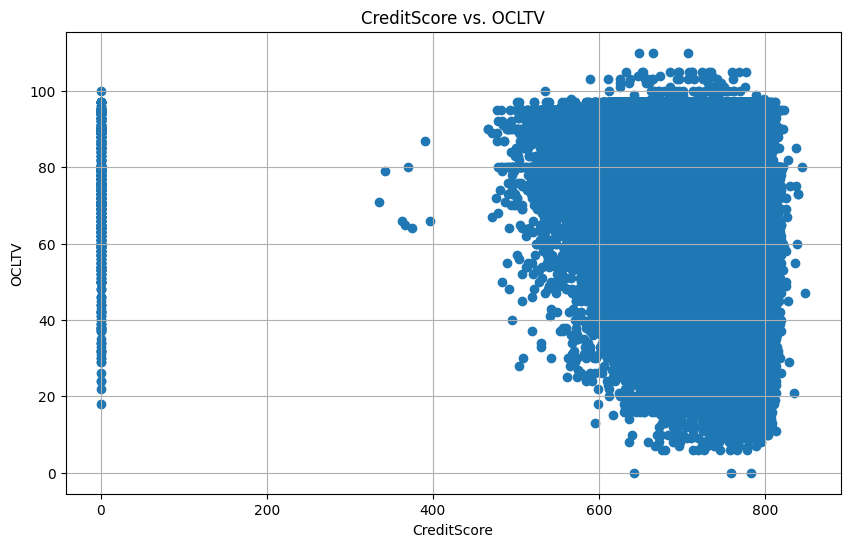

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OCLTV'])
plt.title('CreditScore vs. OCLTV')
plt.xlabel('CreditScore')
plt.ylabel('OCLTV')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OCLTV'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OCLTV'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['CreditScore'][df_no_duplicate_rows['OCLTV'] == lp] for lp in df_no_duplicate_rows['OCLTV'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: -0.1923301739135784
Spearman correlation: -0.24558009463817138
ANOVA F-value: 116.18466785546168, p-value: 0.0


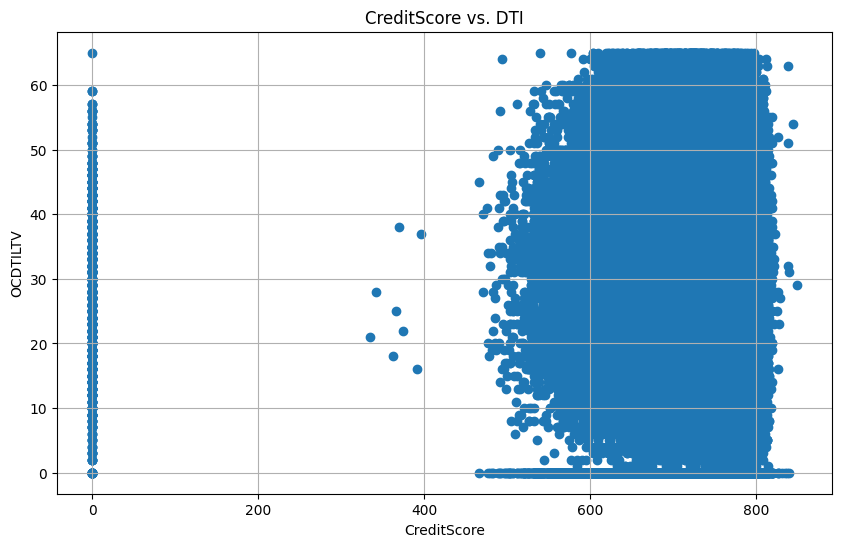

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['DTI'])
plt.title('CreditScore vs. DTI')
plt.xlabel('CreditScore')
plt.ylabel('OCDTILTV')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['DTI'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['DTI'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['CreditScore'][df_no_duplicate_rows['DTI'] == lp] for lp in df_no_duplicate_rows['DTI'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: -0.1034238623510495
Spearman correlation: -0.17371334484059406
ANOVA F-value: 65.55124767887573, p-value: 0.0


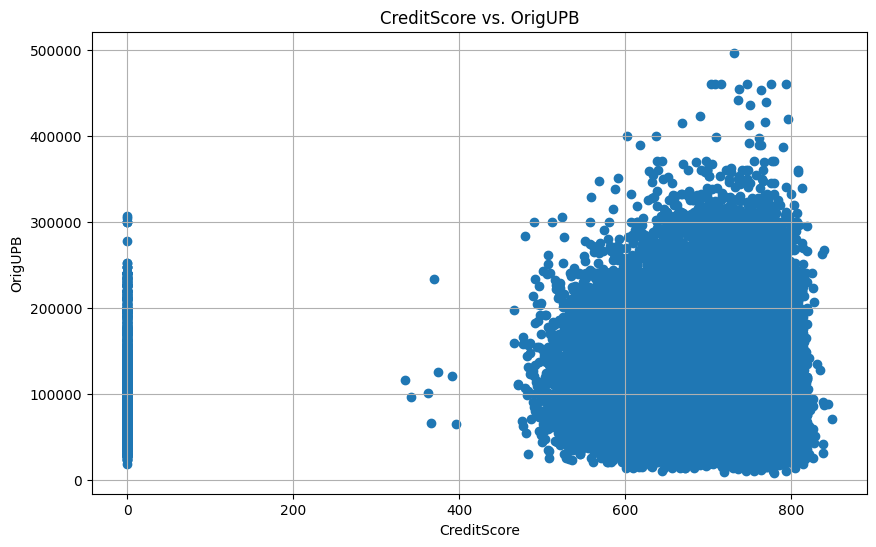

In [ ]:

plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OrigUPB'])
plt.title('CreditScore vs. OrigUPB')
plt.xlabel('CreditScore')
plt.ylabel('OrigUPB')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OrigUPB'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OrigUPB'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['CreditScore'][df_no_duplicate_rows['OrigUPB'] == lp] for lp in df_no_duplicate_rows['OrigUPB'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: 0.0029911013788148366
Spearman correlation: -0.015725845321973186
ANOVA F-value: 4.6559422092688365, p-value: 7.326585269030908e-171


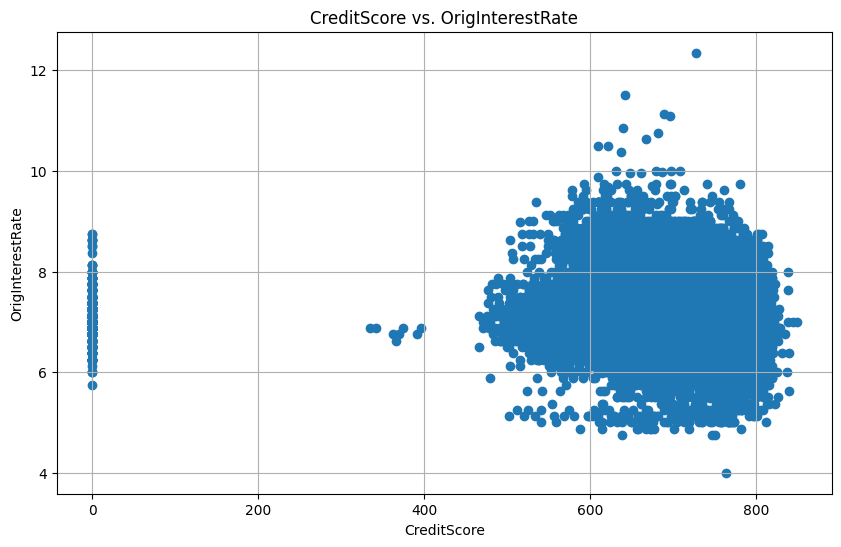

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OrigInterestRate'])
plt.title('CreditScore vs. OrigInterestRate')
plt.xlabel('CreditScore')
plt.ylabel('OrigInterestRate')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OrigInterestRate'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['OrigInterestRate'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['CreditScore'][df_no_duplicate_rows['OrigInterestRate'] == lp] for lp in df_no_duplicate_rows['OrigInterestRate'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: -0.11958356696916064
Spearman correlation: -0.13268592174820046
ANOVA F-value: 16.948261412690886, p-value: 0.0


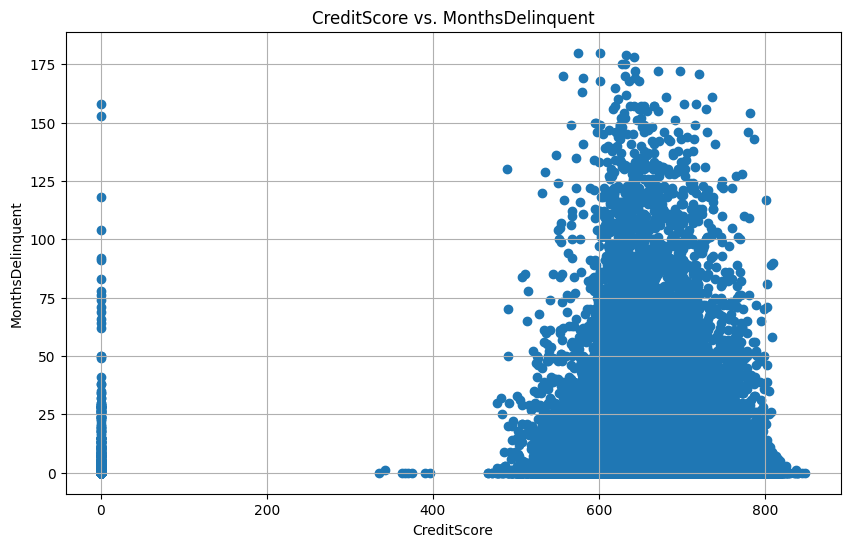

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['MonthsDelinquent'])
plt.title('CreditScore vs. MonthsDelinquent')
plt.xlabel('CreditScore')
plt.ylabel('MonthsDelinquent')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['MonthsDelinquent'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['CreditScore'], df_no_duplicate_rows['MonthsDelinquent'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['CreditScore'][df_no_duplicate_rows['MonthsDelinquent'] == lp] for lp in df_no_duplicate_rows['MonthsDelinquent'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: -0.15042678564090098
Spearman correlation: -0.2708818250323297
ANOVA F-value: 92.68242300899242, p-value: 0.0


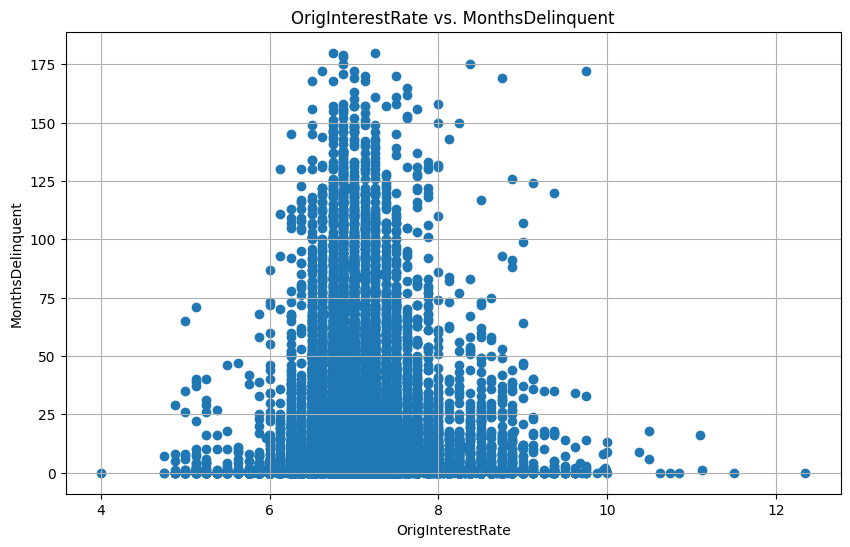

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['MonthsDelinquent'])
plt.title('OrigInterestRate vs. MonthsDelinquent')
plt.xlabel('OrigInterestRate')
plt.ylabel('MonthsDelinquent')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['MonthsDelinquent'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['MonthsDelinquent'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['OrigInterestRate'][df_no_duplicate_rows['MonthsDelinquent'] == lp] for lp in df_no_duplicate_rows['MonthsDelinquent'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: 0.052441416168111224
Spearman correlation: 0.0587375244803918
ANOVA F-value: 10.70684649935187, p-value: 6.113256194640348e-276


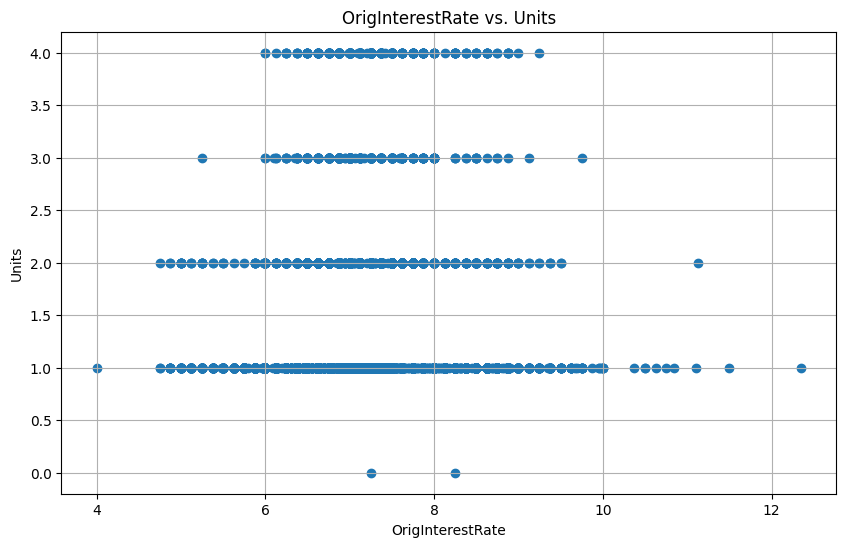

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['Units'])
plt.title('OrigInterestRate vs. Units')
plt.xlabel('OrigInterestRate')
plt.ylabel('Units')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['Units'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['Units'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['OrigInterestRate'][df_no_duplicate_rows['Units'] == lp] for lp in df_no_duplicate_rows['Units'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: 0.07291239357347425
Spearman correlation: 0.06719044627675307
ANOVA F-value: 389.35314637535834, p-value: 0.0


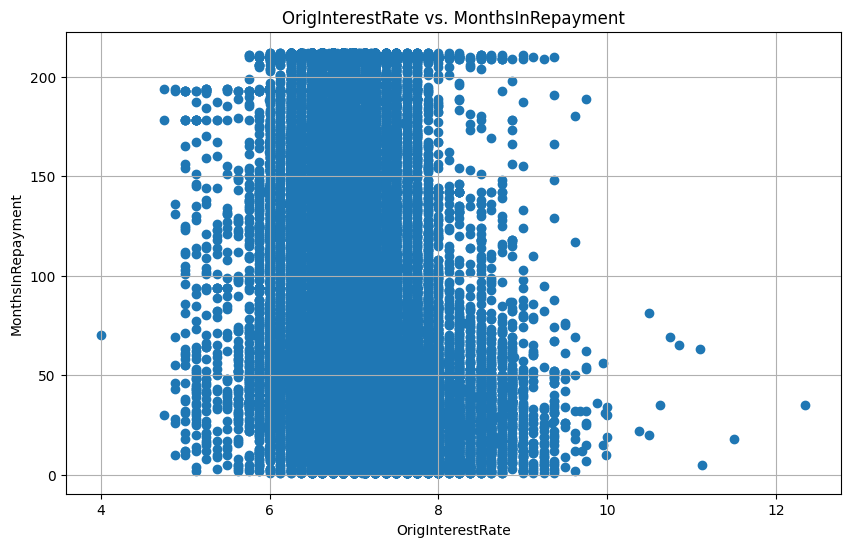

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['MonthsInRepayment'])
plt.title('OrigInterestRate vs. MonthsInRepayment')
plt.xlabel('OrigInterestRate')
plt.ylabel('MonthsInRepayment')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['MonthsInRepayment'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['MonthsInRepayment'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['OrigInterestRate'][df_no_duplicate_rows['MonthsInRepayment'] == lp] for lp in df_no_duplicate_rows['MonthsInRepayment'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: -0.12197030575066589
Spearman correlation: -0.16749681647141854
ANOVA F-value: 50.22729508624662, p-value: 0.0


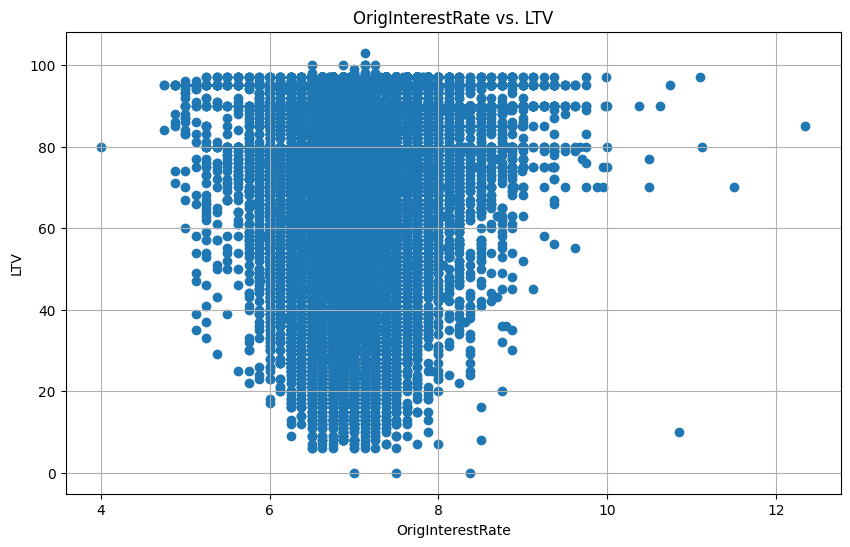

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['LTV'])
plt.title('OrigInterestRate vs. LTV')
plt.xlabel('OrigInterestRate')
plt.ylabel('LTV')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['LTV'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['OrigInterestRate'], df_no_duplicate_rows['LTV'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['OrigInterestRate'][df_no_duplicate_rows['LTV'] == lp] for lp in df_no_duplicate_rows['LTV'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: 0.09910480617520215
Spearman correlation: 0.10801155343157032
ANOVA F-value: 66.83883251502067, p-value: 0.0


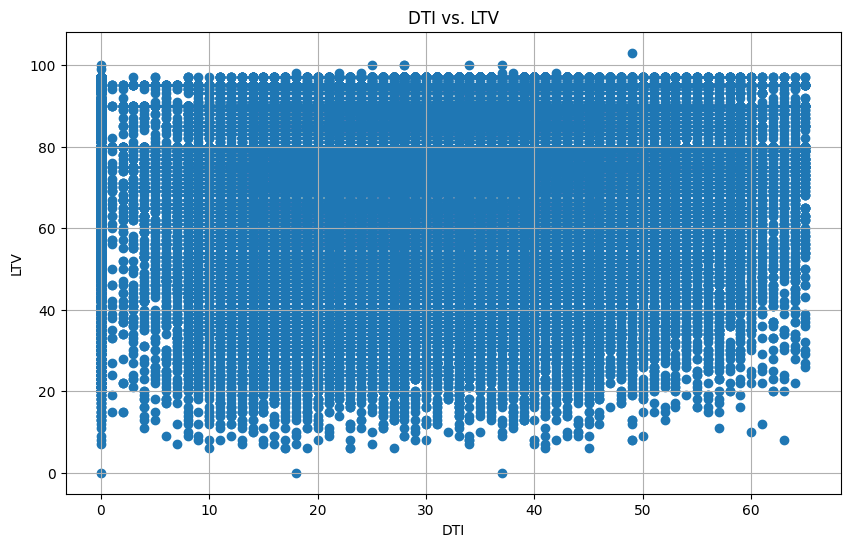

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['DTI'], df_no_duplicate_rows['LTV'])
plt.title('DTI vs. LTV')
plt.xlabel('DTI')
plt.ylabel('LTV')
plt.grid(True)
plt.show()

In [ ]:
# Compute Pearson's Correlation
corr, _ = pearsonr(df_no_duplicate_rows['DTI'], df_no_duplicate_rows['LTV'])
print(f'Pearson correlation: {corr}')
# Compute Spearman's Correlation
spearman_corr, _ = spearmanr(df_no_duplicate_rows['DTI'], df_no_duplicate_rows['LTV'])
print(f'Spearman correlation: {spearman_corr}')
# Perform ANOVA
loan_purpose_groups = [df_no_duplicate_rows['DTI'][df_no_duplicate_rows['LTV'] == lp] for lp in df_no_duplicate_rows['LTV'].unique()]
anova_result = f_oneway(*loan_purpose_groups)
print(f'ANOVA F-value: {anova_result.statistic}, p-value: {anova_result.pvalue}')

Pearson correlation: 0.12157191541995063
Spearman correlation: 0.14072607007533594
ANOVA F-value: 50.16026163240246, p-value: 0.0


Categorical VS numerical

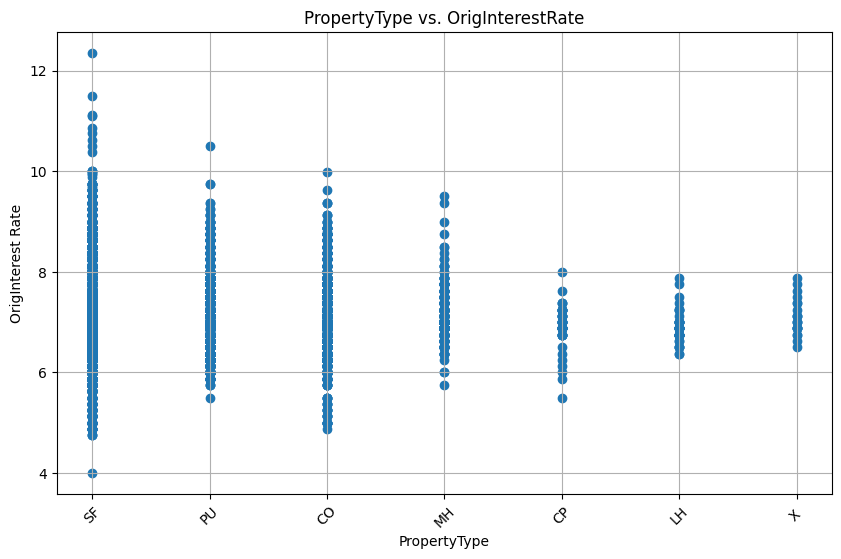

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['PropertyType'], df_no_duplicate_rows['OrigInterestRate'])
plt.title('PropertyType vs. OrigInterestRate')
plt.xlabel('PropertyType')
plt.ylabel('OrigInterest Rate')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)
plt.show()


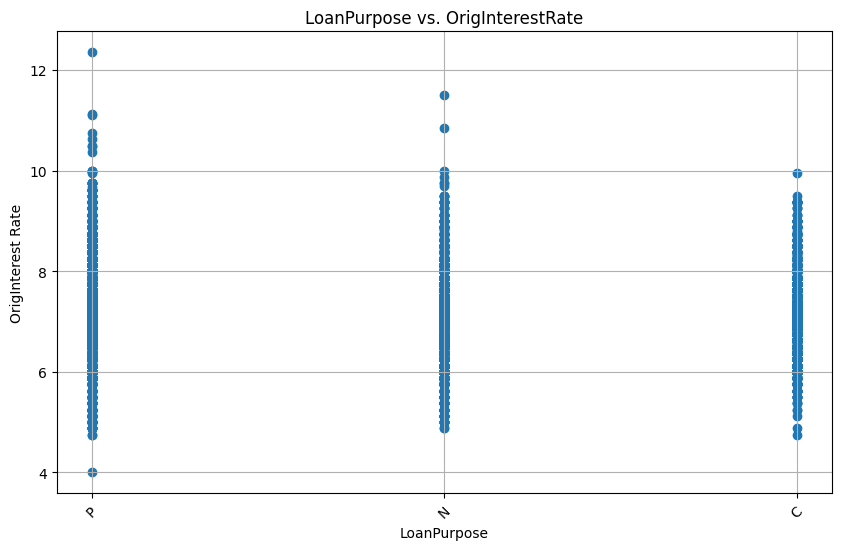

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['LoanPurpose'], df_no_duplicate_rows['OrigInterestRate'])
plt.title('LoanPurpose vs. OrigInterestRate')
plt.xlabel('LoanPurpose')
plt.ylabel('OrigInterest Rate')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)
plt.show()

In [ ]:
df_no_duplicate_rows.columns

Index(['CreditScore', 'FirstPaymentDate', 'FirstTimeHomebuyer', 'MaturityDate',
       'MSA', 'MIP', 'Units', 'Occupancy', 'OCLTV', 'DTI', 'OrigUPB', 'LTV',
       'OrigInterestRate', 'Channel', 'PPM', 'ProductType', 'PropertyState',
       'PropertyType', 'PostalCode', 'LoanSeqNum', 'LoanPurpose',
       'OrigLoanTerm', 'NumBorrowers', 'SellerName', 'ServicerName',
       'EverDelinquent', 'MonthsDelinquent', 'MonthsInRepayment'],
      dtype='object')

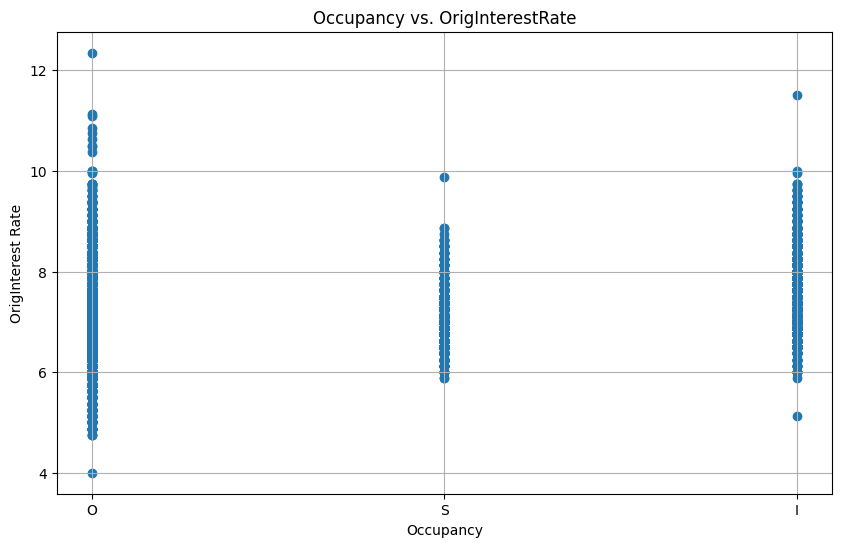

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['Occupancy'], df_no_duplicate_rows['OrigInterestRate'])
plt.title('Occupancy vs. OrigInterestRate')
plt.xlabel('Occupancy')
plt.ylabel('OrigInterest Rate')
plt.grid(True)
plt.show()


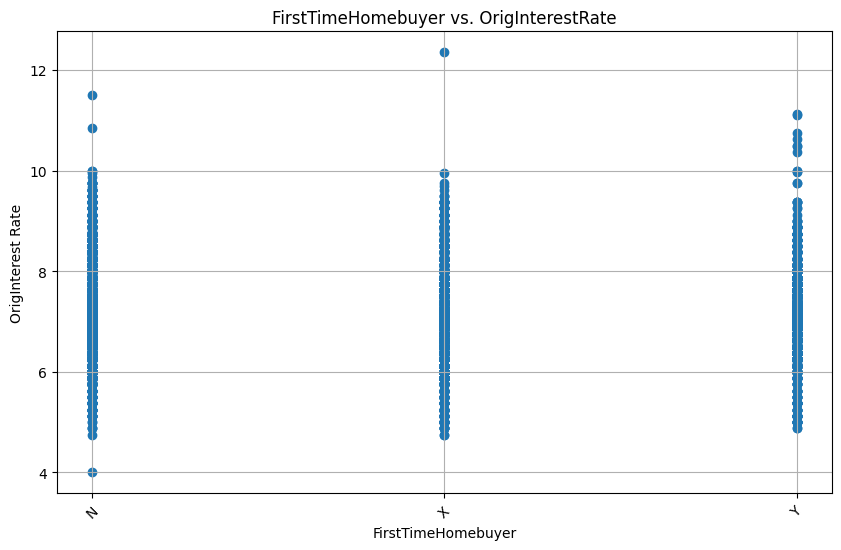

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['FirstTimeHomebuyer'], df_no_duplicate_rows['OrigInterestRate'])
plt.title('FirstTimeHomebuyer vs. OrigInterestRate')
plt.xlabel('FirstTimeHomebuyer')
plt.ylabel('OrigInterest Rate')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)
plt.show()

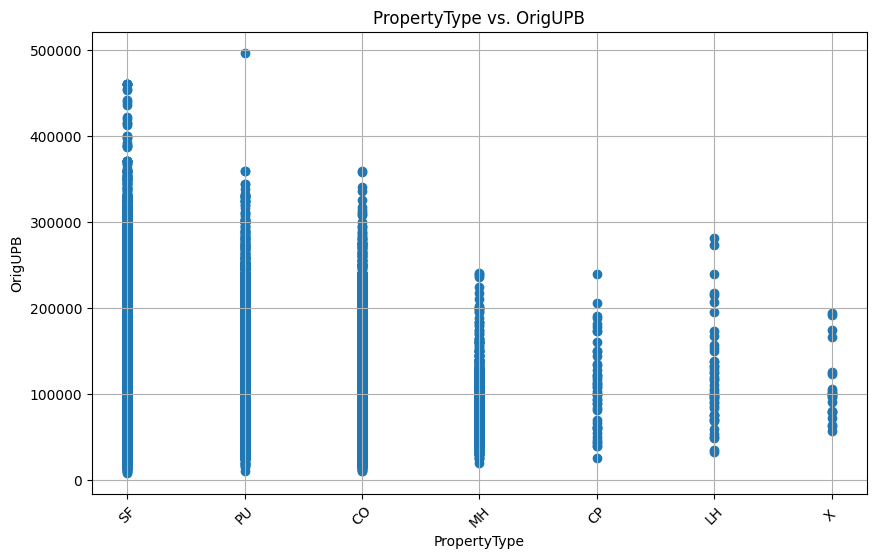

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['PropertyType'], df_no_duplicate_rows['OrigUPB'])
plt.title('PropertyType vs. OrigUPB')
plt.xlabel('PropertyType')
plt.ylabel('OrigUPB')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)
plt.show()

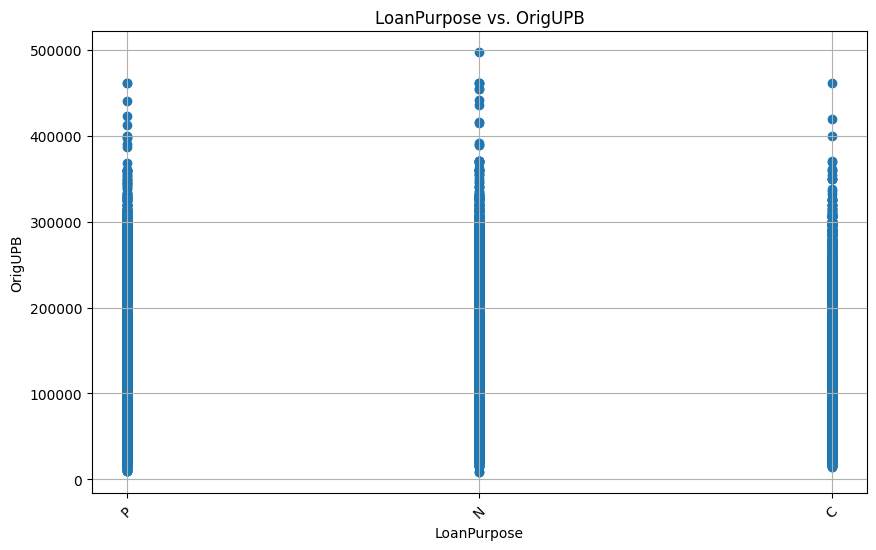

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['LoanPurpose'], df_no_duplicate_rows['OrigUPB'])
plt.title('LoanPurpose vs. OrigUPB')
plt.xlabel('LoanPurpose')
plt.ylabel('OrigUPB')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)
plt.show()

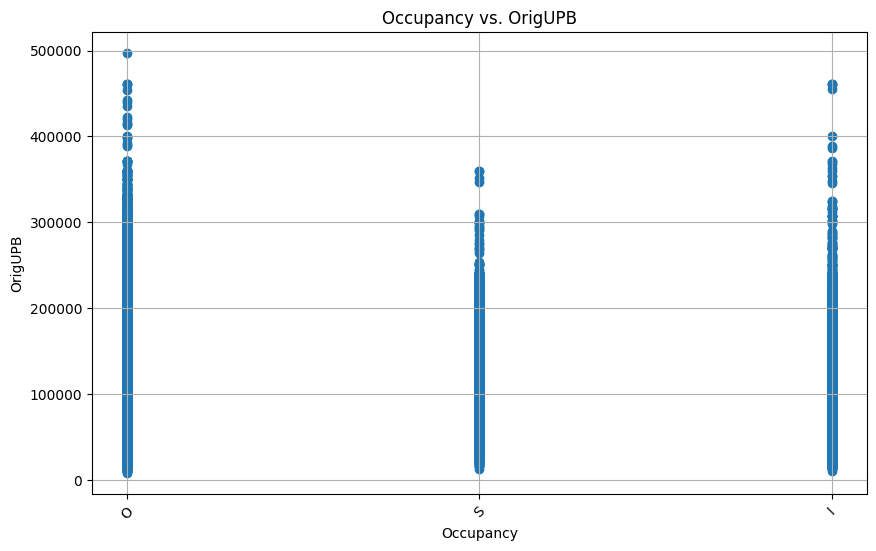

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['Occupancy'], df_no_duplicate_rows['OrigUPB'])
plt.title('Occupancy vs. OrigUPB')
plt.xlabel('Occupancy')
plt.ylabel('OrigUPB')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)
plt.show()

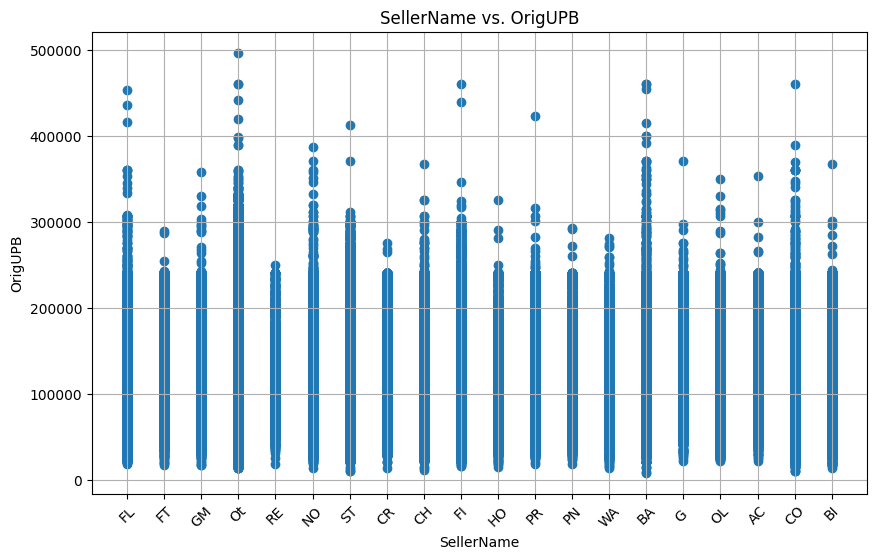

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(df_no_duplicate_rows['SellerName'], df_no_duplicate_rows['OrigUPB'])
plt.title('SellerName vs. OrigUPB')
plt.xlabel('SellerName')
plt.ylabel('OrigUPB')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)
plt.show()


we will continue the EDA steps in the other notebook

Save the transformed data

In [ ]:
df_no_duplicate_rows.head()

,CreditScore,FirstPaymentDate,FirstTimeHomebuyer,MaturityDate,MSA,MIP,Units,Occupancy,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,Channel,PPM,ProductType,PropertyState,PropertyType,PostalCode,LoanSeqNum,LoanPurpose,OrigLoanTerm,NumBorrowers,SellerName,ServicerName,EverDelinquent,MonthsDelinquent,MonthsInRepayment
0,0,1999-02-01,N,2029-01-01,16974,25,1,O,89,27,117000,89,6.750,T,N,FRM,IL,SF,60400,F199Q1268030,P,360,2,FL,WASHINGTONMUTUALBANK,0,0,52
1,0,1999-02-01,N,2029-01-01,19740,0,1,O,73,17,109000,73,6.500,R,N,FRM,CO,SF,80200,F199Q1015092,N,360,1,FT,CHASEHOMEFINANCELLC,0,0,144
2,0,1999-02-01,N,2029-01-01,29940,0,1,O,75,16,88000,75,6.875,T,N,FRM,KS,SF,66000,F199Q1266886,N,360,2,FL,WASHINGTONMUTUALBANK,0,0,67
3,0,1999-02-01,N,2029-01-01,31084,0,1,O,76,14,160000,76,6.875,R,N,FRM,CA,SF,90700,F199Q1178167,N,360,2,GM,GMACMTGECORP,0,0,35
4,0,1999-02-01,N,2029-01-01,35644,0,1,O,78,18,109000,78,7.125,R,N,FRM,NJ,SF,7600,F199Q1178517,N,360,2,GM,GMACMTGECORP,0,0,54


In [ ]:
df_no_duplicate_rows.info()

<class 'pandas.core.frame.DataFrame'>
Index: 266457 entries, 0 to 291450
Data columns (total 28 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   CreditScore         266457 non-null  int64         
 1   FirstPaymentDate    266457 non-null  datetime64[ns]
 2   FirstTimeHomebuyer  266457 non-null  object        
 3   MaturityDate        266457 non-null  datetime64[ns]
 4   MSA                 266457 non-null  object        
 5   MIP                 266457 non-null  int64         
 6   Units               266457 non-null  int64         
 7   Occupancy           266457 non-null  object        
 8   OCLTV               266457 non-null  int64         
 9   DTI                 266457 non-null  int64         
 10  OrigUPB             266457 non-null  int64         
 11  LTV                 266457 non-null  int64         
 12  OrigInterestRate    266457 non-null  float64       
 13  Channel             266457 non-nul

In [ ]:
df_no_duplicate_rows.to_csv('/content/drive/MyDrive/Prepayment-Mortgage-Trading-Analysis-and-Prediction/MyNewdata.csv',index=False)